In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# ! ln -s /content/drive/MyDrive/XAI-CV-CounterfactualSamples .
! ln -s /content/drive/MyDrive/src/XAI-CV-CounterfactualSamples .

In [3]:
%cd XAI-CV-CounterfactualSamples

/content/drive/MyDrive/src/XAI-CV-CounterfactualSamples


In [ ]:
# ! ln -s /content/drive/MyDrive/datasets/BreakHis_v1 datasets

In [4]:
%cd exp_breakhis

/content/drive/MyDrive/src/XAI-CV-CounterfactualSamples/exp_breakhis


In [5]:
! pip install tensorflow==2.15.1 > /content/install.log 2> /content/err.log

# Initialization

In [6]:
import tensorflow as tf
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

print(tf.__version__)

2.15.1


In [7]:
import warnings
warnings.filterwarnings('ignore')

In [8]:
import importlib
import configs
importlib.reload(configs)

<module 'configs' from '/content/drive/MyDrive/src/XAI-CV-CounterfactualSamples/exp_breakhis/configs.py'>

# Data Loader

In [9]:
class MyDataGenerator(tf.keras.utils.Sequence):
    def __init__(self, data_dir, subsets_file, subset,
                       batch_size=32, shuffle=False):
        self.data_dir = data_dir
        self.subsets_file = subsets_file
        self.subset = subset
        self.batch_size = batch_size
        self.shuffle = shuffle

        self.filenames = None
        self.classnames = None
        self.dict_class_names = None

        self.load_data()
        self.indices = None
        self.on_epoch_end()

    def load_data(self):
        df_files = pd.read_csv(self.subsets_file, header='infer')
        self.df_files = df_files[df_files['grp'] == self.subset]
        self.filenames = self.df_files['filename'].tolist()
        self.classnames = self.df_files['classname'].tolist()
        self.dict_class_names = {
            name:i for i, name in enumerate(configs.CLASS_NAMES)
        }
        print('*** load_data')
        print(self.subset)
        print(len(self.filenames), 'found')
        print(df_files.head())
        print('***')

    def __len__(self):
        return int(np.ceil(len(self.filenames) / self.batch_size))

    def __getitem__(self, index):
        indices = self.indices[index*self.batch_size:(index+1)*self.batch_size]
        filenames = [self.filenames[k] for k in indices]
        classnames = [self.classnames[k] for k in indices]
        X, Y = self.__data_generation(filenames, classnames)
        return X, Y

    def on_epoch_end(self):
        self.indices = np.arange(len(self.filenames))
        if self.shuffle == True:
            np.random.shuffle(self.indices)

    def toOneHot(self, classname):
        v = np.zeros(configs.NUM_CLASS, dtype=np.float64)
        v[self.dict_class_names[classname]] = 1.0
        return v

    def __data_generation(self, filenames, classnames):
        num = len(filenames)
        X = np.empty([num, *configs.IMAGE_SIZE], dtype=np.float64)
        Y = np.empty([num, configs.NUM_CLASS])
        HH, WW, _ = configs.IMAGE_SIZE
        for i, fn in enumerate(filenames):
            img = plt.imread(configs.DATA_DIR+'/'+fn)
            delta = (WW - HH) // 2
            img = img[:, delta:WW-delta-1]
            img = cv2.resize(img, configs.IMAGE_SIZE[:2])
            X[i] = np.array(img, dtype=np.float64)
            Y[i] = self.toOneHot(classnames[i])

        return X, {'classifier256':Y, 'out_img':X}

In [10]:
train_datagen = MyDataGenerator(configs.DATA_DIR,
                                configs.SUBSETS_FILE,
                                'train',
                                shuffle=True)
val_datagen = MyDataGenerator(configs.DATA_DIR,
                              configs.SUBSETS_FILE,
                              'val',
                              shuffle=False)
test_datagen = MyDataGenerator(configs.DATA_DIR,
                               configs.SUBSETS_FILE,
                               'test',
                               shuffle=False)

*** load_data
train
4000 found
   mag    grp                                           filename  \
0   40  train  malignant/SOB/mucinous_carcinoma/SOB_M_MC_14-1...   
1  400  train  malignant/SOB/ductal_carcinoma/SOB_M_DC_14-110...   
2  100  train  benign/SOB/adenosis/SOB_B_A_14-22549CD/100X/SO...   
3  100  train  malignant/SOB/mucinous_carcinoma/SOB_M_MC_14-1...   
4   40  train  benign/SOB/adenosis/SOB_B_A_14-22549CD/40X/SOB...   

            classname  
0  mucinous_carcinoma  
1    ductal_carcinoma  
2            adenosis  
3  mucinous_carcinoma  
4            adenosis  
***
*** load_data
val
1000 found
   mag    grp                                           filename  \
0   40  train  malignant/SOB/mucinous_carcinoma/SOB_M_MC_14-1...   
1  400  train  malignant/SOB/ductal_carcinoma/SOB_M_DC_14-110...   
2  100  train  benign/SOB/adenosis/SOB_B_A_14-22549CD/100X/SO...   
3  100  train  malignant/SOB/mucinous_carcinoma/SOB_M_MC_14-1...   
4   40  train  benign/SOB/adenosis/SOB_B_A_

(32, 256, 256, 3)
[[0. 0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 0. 0. 0. 1.]
 [0. 1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1. 0.]]


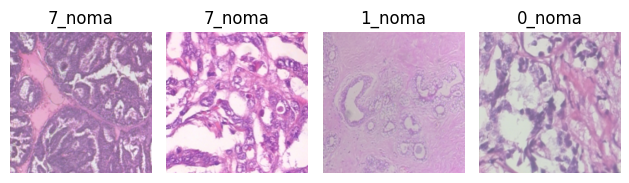

In [ ]:
X, Ys = train_datagen[0]
Y_img, Y_cls = Ys['out_img'], Ys['classifier256']
print(X.shape)
print(Y_cls[:5])

for i in range(4):
  plt.subplot(1, 4, i+1)
  plt.imshow((X[i]*255).astype(np.uint8))
  plt.axis('off')
  class_id = Y_cls[i].argmax()
  plt.title(str(class_id)+'_'+configs.CLASS_NAMES[class_id][-4:])
plt.tight_layout()
plt.show()

# Generator 256 x 256

In [11]:
class GeneratorBuilder():
    def double_conv_block(self, x, n_filters):
        x = tf.keras.layers.Conv2D(n_filters, 3,
                                   padding="same", activation="relu")(x)
        x = tf.keras.layers.Conv2D(n_filters, 3,
                                   padding="same", activation="relu")(x)
        return x

    def downsample_block(self, x, n_filters):
        f = self.double_conv_block(x, n_filters)
        p = tf.keras.layers.MaxPool2D(2)(f)
        p = tf.keras.layers.Dropout(0.5)(p)
        return f, p

    def upsample_block(self, x, conv_features, n_filters):
        x = tf.keras.layers.Conv2DTranspose(n_filters, 3, 2, padding="same")(x)
        x = tf.keras.layers.concatenate([x, conv_features])
        x = tf.keras.layers.Dropout(0.5)(x)
        x = self.double_conv_block(x, n_filters)
        return x

    def build_unet_model(self, input_shape, classifier, name):
        inputs = tf.keras.layers.Input(shape=input_shape)

        f1, p1 = self.downsample_block(inputs, 64)      # 128
        f2, p2 = self.downsample_block(p1, 128)         # 64
        f3, p3 = self.downsample_block(p2, 256)         # 32
        f4, p4 = self.downsample_block(p3, 512)         # 16
        bottleneck = self.double_conv_block(p4, 512)
        u5 = self.upsample_block(bottleneck, f4, 512)   # 32
        u6 = self.upsample_block(u5, f3, 256)           # 64
        u7 = self.upsample_block(u6, f2, 128)           # 128
        u8 = self.upsample_block(u7, f1, 64)            # 256

        # out_img
        out_img = tf.keras.layers.Conv2D(3, 1, padding="same",
                                activation = "sigmoid", name="out_img")(u8)

        # outputs_class
        classifier.trainable = False
        out_cls = classifier(out_img)

        unet_model = tf.keras.Model(inputs,
                                    outputs=[out_img, out_cls],
                                    name=name)

        return unet_model

In [12]:
classifier = tf.keras.models.load_model(
    configs.CLASSIFIER256_CHECKPOINT
)

In [13]:
model = GeneratorBuilder().build_unet_model(
    configs.IMAGE_SIZE,
    classifier,
    'generator256'
)
model.summary()

Model: "generator256"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         1792      ['input_1[0][0]']             
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 64)         36928     ['conv2d[0][0]']              
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 128, 128, 64)         0         ['conv2d_1[0][0]']            
 D)                                                                                    

# Custom Loss

In [14]:
class CounterfactualCustomLoss(tf.keras.losses.Loss):
    def __init__(self):
        super(CounterfactualCustomLoss, self).__init__()

    def call(self, y_true, y_pred):
        return tf.reduce_mean(
                    tf.square(tf.reduce_sum(y_true * y_pred, axis=1)
                    )
                )

In [15]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss={'out_img':tf.losses.MeanSquaredError(),
                    'classifier256':CounterfactualCustomLoss()},
              loss_weights={'out_img':1,
                            'classifier256':1/10},
              metrics=[])

# Training

In [ ]:
cb_early_stop = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=1e-4,
    patience=5,
    verbose=1,
    mode='auto'
)
cb_model_checkpoint = tf.keras.callbacks.ModelCheckpoint(
    configs.CHECKPOINTS_DIR + '/' + model.name + '/',
    monitor='val_loss',
    verbose=1,
    save_best_only=True,
    save_weights_only=True,
    mode='auto'
)
cb_reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.1,
    patience=5,
    verbose=1,
    mode='auto',
    min_delta=1e-4,
    min_lr=0
)

callbacks = [cb_model_checkpoint,
             cb_reduce_lr,
             cb_early_stop]

In [ ]:
model.outputs

[<KerasTensor: shape=(None, 256, 256, 3) dtype=float32 (created by layer 'out_img')>,
 <KerasTensor: shape=(None, 8) dtype=float32 (created by layer 'classifier256')>]

In [ ]:
history = model.fit_generator(train_datagen,
                    epochs=2024,
                    verbose=1,
                    callbacks=callbacks,
                    validation_data=val_datagen)

pd.DataFrame.from_dict(history.history) \
            .to_csv(configs.CHECKPOINTS_DIR+'/'+
                    model.name+'/history_generator.csv',
                    index=False)

<ipython-input-24-0cb2258224fc>:1: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(train_datagen,


Epoch 1/2024
125/125 [==============================] - ETA: 0s - loss: 0.0186 - out_img_loss: 0.0168 - classifier256_loss: 0.0180 
Epoch 1: val_loss improved from inf to 0.01141, saving model to checkpoints//generator256/
125/125 [==============================] - 2282s 17s/step - loss: 0.0186 - out_img_loss: 0.0168 - classifier256_loss: 0.0180 - val_loss: 0.0114 - val_out_img_loss: 0.0092 - val_classifier256_loss: 0.0220 - lr: 1.0000e-04
Epoch 2/2024
125/125 [==============================] - ETA: 0s - loss: 0.0093 - out_img_loss: 0.0074 - classifier256_loss: 0.0194
Epoch 2: val_loss improved from 0.01141 to 0.00772, saving model to checkpoints//generator256/
125/125 [==============================] - 315s 3s/step - loss: 0.0093 - out_img_loss: 0.0074 - classifier256_loss: 0.0194 - val_loss: 0.0077 - val_out_img_loss: 0.0051 - val_classifier256_loss: 0.0264 - lr: 1.0000e-04
Epoch 3/2024
125/125 [==============================] - ETA: 0s - loss: 0.0065 - out_img_loss: 0.0044 - classif

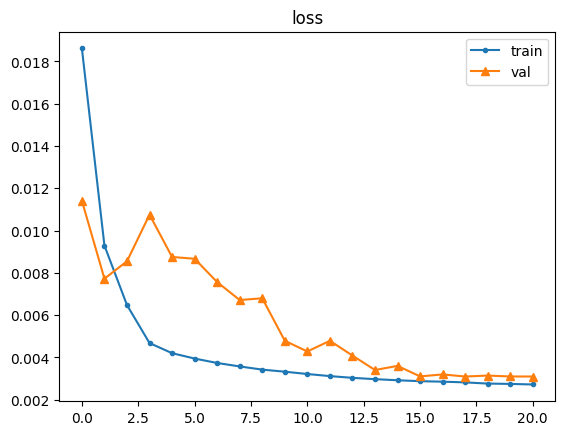

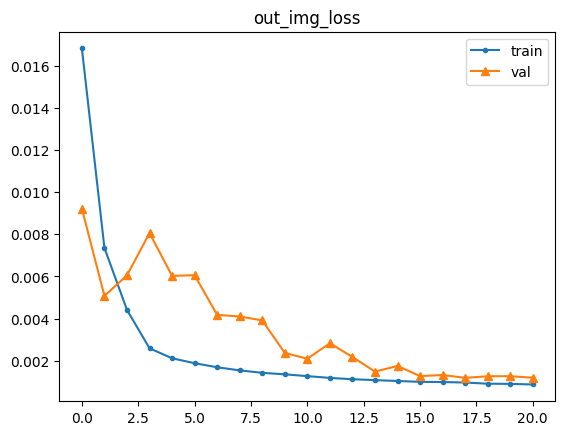

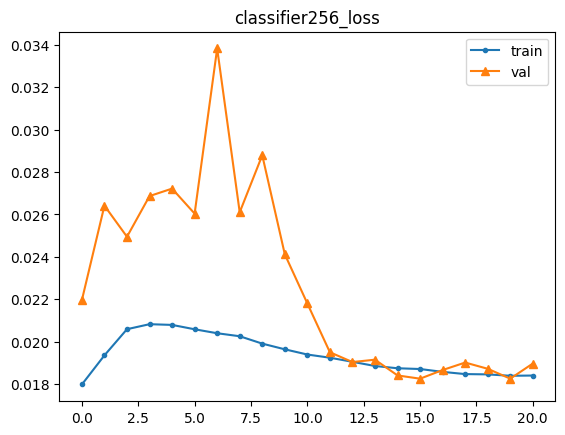

In [ ]:
df = pd.read_csv('checkpoints/generator256/history_generator.csv')

plt.plot(df['loss'], label='train', marker='.')
plt.plot(df['val_loss'], label='val', marker='^')
plt.legend()
plt.title('loss')
plt.show()

plt.plot(df['out_img_loss'], label='train', marker='.')
plt.plot(df['val_out_img_loss'], label='val', marker='^')
plt.legend()
plt.title('out_img_loss')
plt.show()

plt.plot(df['classifier256_loss'], label='train', marker='.')
plt.plot(df['val_classifier256_loss'], label='val', marker='^')
plt.legend()
plt.title('classifier256_loss')
plt.show()

# Evaluation - Images

In [16]:
model.load_weights('checkpoints/generator256-202411222103/')
classifier = tf.keras.models.load_model(
    configs.CLASSIFIER256_CHECKPOINT
)

IsADirectoryError: [Errno 21] Unable to synchronously open file (file read failed: time = Fri Nov 22 14:07:04 2024
, filename = 'checkpoints/generator256-202411222103/', file descriptor = 72, errno = 21, error message = 'Is a directory', buf = 0x7ffe5f809638, total read size = 8, bytes this sub-read = 8, bytes actually read = 18446744073709551615, offset = 0)

In [ ]:
train_loss = model.evaluate_generator(train_datagen, verbose=1)
val_loss = model.evaluate_generator(val_datagen, verbose=1)
test_loss = model.evaluate_generator(test_datagen, verbose=1)
print(train_loss, val_loss, test_loss)

91/91 [==============================] - 2622s 29s/step - loss: 0.0031 - out_img_loss: 0.0012 - classifier256_loss: 0.0193
[0.0032310623209923506, 0.0012082596076652408, 0.02022802084684372] [0.003096620552241802, 0.0011947689345106483, 0.019018515944480896] [0.00311381951905787, 0.0011863388353958726, 0.019274812191724777]


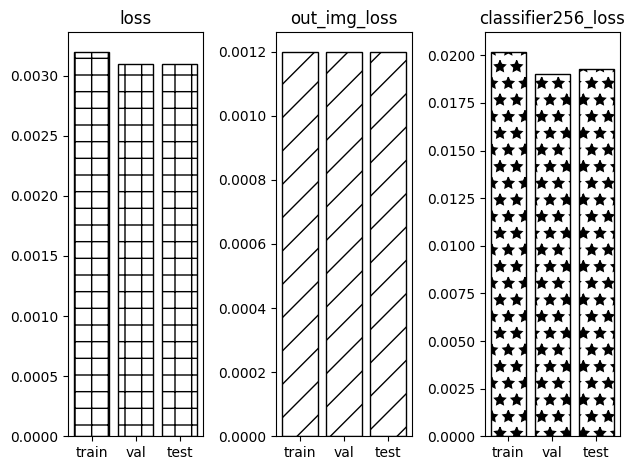

In [18]:
plt.subplot(1, 3, 1)
plt.bar(['train', 'val', 'test'], [0.0032, 0.0031, 0.0031], color='white',
                                edgecolor='black', hatch='+')
plt.title('loss')

plt.subplot(1, 3, 2)
plt.bar(['train', 'val', 'test'], [0.0012, 0.0012, 0.0012], color='white',
                                edgecolor='black', hatch='/')
plt.title('out_img_loss')

plt.subplot(1, 3, 3)
plt.bar(['train', 'val', 'test'], [0.0202, 0.0190, 0.0193], color='white',
                                edgecolor='black', hatch='*')
plt.title('classifier256_loss')
plt.tight_layout()
plt.show()

In [19]:
def plot_generated_images(X, generator, classifier, num=-1):
  X_, Y_ = generator.predict(X, verbose=0)
  Y_cls_original = classifier.predict(X)
  Y_cls_counter = classifier.predict(X_)
  D = X - X_
  print(X_.shape, Y_.shape)

  num = 4 if num > 0 else X.shape[0]
  np.set_printoptions(precision=4)
  for i in range(num):
    print(f'*** sample {i}')
    print(Y_cls_original[i])
    print(Y_cls_counter[i])

    plt.subplot(1, 3, 1)
    plt.imshow((X[i]*255).astype(np.uint8))
    plt.axis('off')
    plt.title('original')

    plt.subplot(1, 3, 2)
    plt.imshow((X_[i]*255).astype(np.uint8))
    plt.axis('off')
    plt.title('counterfactual')

    heatmap = (D[i]**2).sum(axis=2)
    heatmap = (heatmap - heatmap.min()) / (heatmap.max() - heatmap.min())

    plt.subplot(1, 3, 3)
    plt.imshow(heatmap)
    plt.axis('off')
    plt.title('difference')

    plt.show()

## train

1/1 [==============================] - 0s 68ms/step
(32, 256, 256, 3) (32, 8)
*** sample 0
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


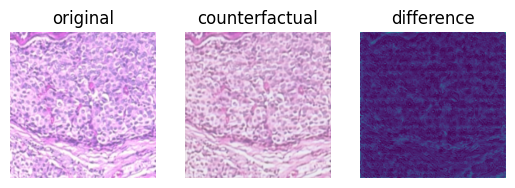

*** sample 1
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


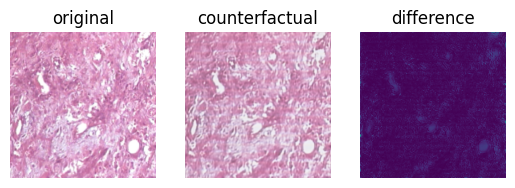

*** sample 2
[0.1028 0.103  0.1028 0.1028 0.1028 0.1038 0.1028 0.2791]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.103  0.1029 0.1029]


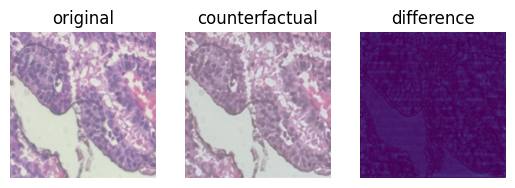

*** sample 3
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2792 0.1027 0.1027 0.1031 0.1027 0.1041 0.1027 0.1027]


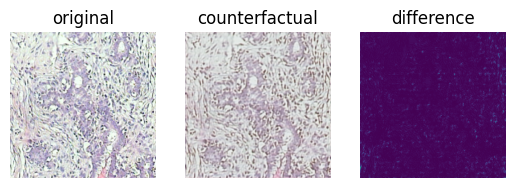

*** sample 4
[0.1028 0.2784 0.1026 0.1028 0.1056 0.1026 0.1026 0.1027]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


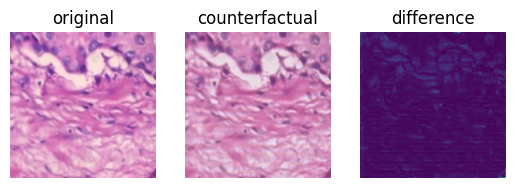

*** sample 5
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2796 0.1029 0.1029 0.1029 0.1029 0.1029 0.1032 0.1029]


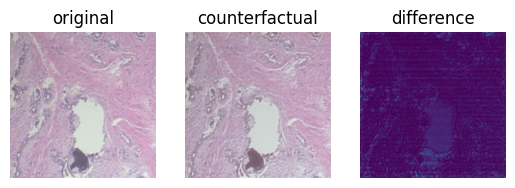

*** sample 6
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2796 0.1029 0.103  0.103  0.1029 0.1029 0.103  0.1029]


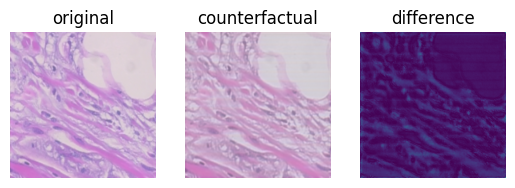

*** sample 7
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


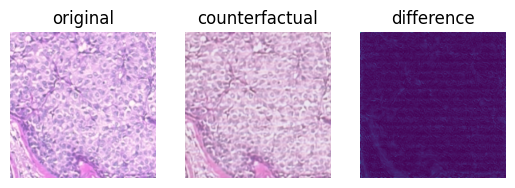

*** sample 8
[0.1029 0.1029 0.1029 0.1029 0.103  0.1029 0.2796 0.1029]
[0.2787 0.1028 0.1027 0.1028 0.1026 0.1026 0.1051 0.1026]


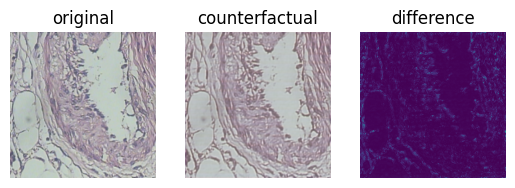

*** sample 9
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.103  0.1029]


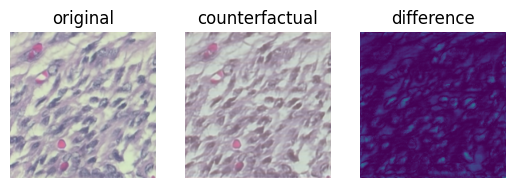

*** sample 10
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.1482 0.2656 0.0977 0.0977 0.0977 0.0977 0.0977 0.0977]


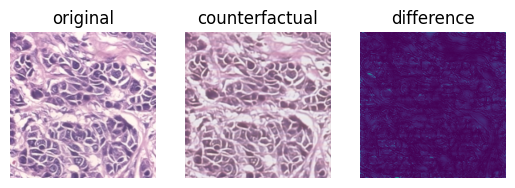

*** sample 11
[0.1029 0.2796 0.1029 0.1029 0.1029 0.1029 0.1029 0.1032]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


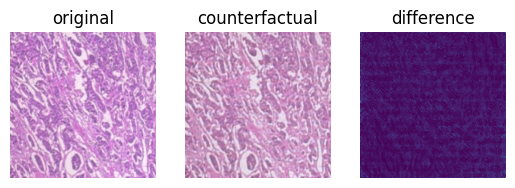

*** sample 12
[0.0933 0.0932 0.0932 0.0932 0.247  0.0932 0.1938 0.0932]
[0.2462 0.1018 0.1007 0.1424 0.1007 0.1054 0.1026 0.1003]


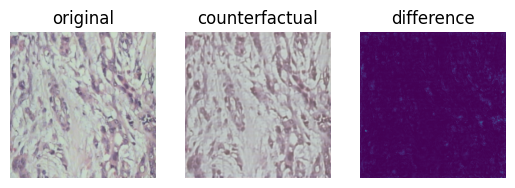

*** sample 13
[0.1029 0.2796 0.1029 0.103  0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


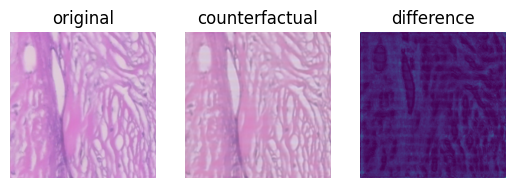

*** sample 14
[0.2796 0.1029 0.1029 0.1029 0.1029 0.1029 0.103  0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


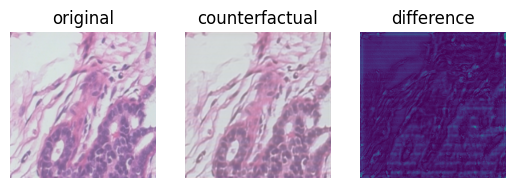

*** sample 15
[0.1034 0.1028 0.1028 0.1028 0.1028 0.1028 0.2796 0.1028]
[0.1597 0.1147 0.1147 0.1464 0.1139 0.1137 0.1236 0.1132]


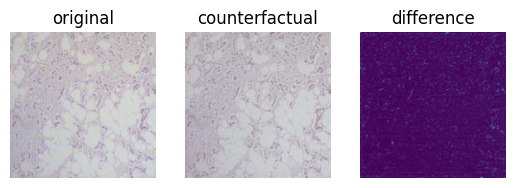

*** sample 16
[0.103  0.1029 0.2794 0.1029 0.1032 0.1029 0.1029 0.1029]
[0.2794 0.1028 0.1036 0.1028 0.1028 0.1029 0.1029 0.1028]


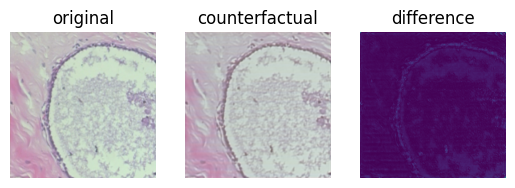

*** sample 17
[0.1322 0.0995 0.27   0.0995 0.1    0.0995 0.0995 0.0996]
[0.2797 0.1029 0.103  0.1029 0.1029 0.1029 0.1029 0.1029]


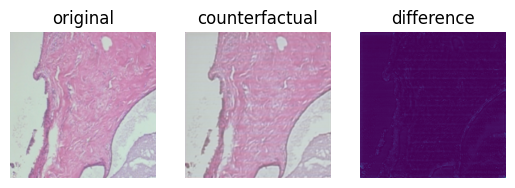

*** sample 18
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.238  0.2339 0.088  0.088  0.088  0.088  0.088  0.088 ]


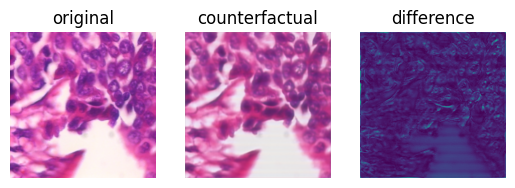

*** sample 19
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


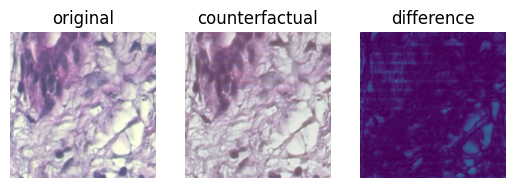

*** sample 20
[0.0983 0.097  0.097  0.1027 0.1873 0.097  0.2238 0.097 ]
[0.1877 0.1065 0.105  0.1396 0.1051 0.1053 0.1453 0.1055]


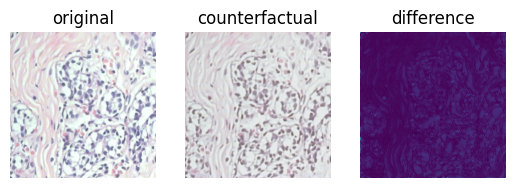

*** sample 21
[0.1027 0.2791 0.1027 0.1047 0.1027 0.1028 0.1027 0.1027]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


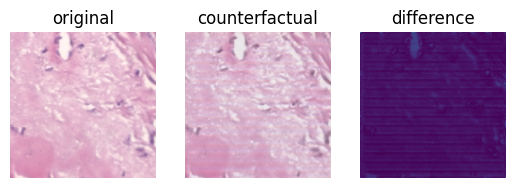

*** sample 22
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2637 0.154  0.0971 0.097  0.097  0.0971 0.0971 0.0971]


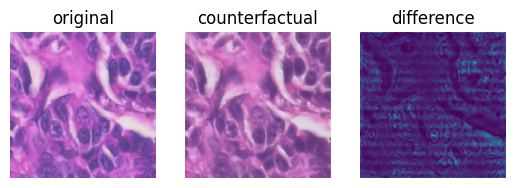

*** sample 23
[0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029 0.1029]
[0.2709 0.0997 0.0997 0.1309 0.0997 0.0997 0.0997 0.0997]


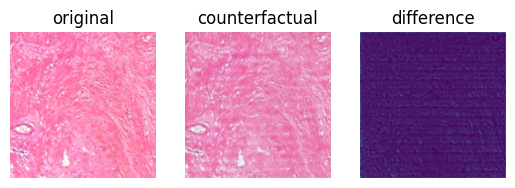

*** sample 24
[0.0897 0.0879 0.0879 0.0879 0.2385 0.0879 0.2322 0.0879]
[0.2735 0.102  0.1022 0.1057 0.102  0.1024 0.1102 0.102 ]


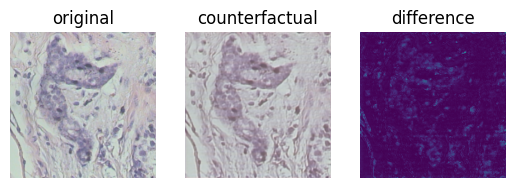

*** sample 25
[0.1028 0.2793 0.1028 0.1034 0.1028 0.1028 0.103  0.1031]
[0.2792 0.1028 0.1029 0.1038 0.1028 0.1028 0.1029 0.1028]


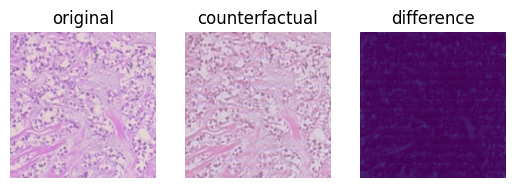

*** sample 26
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2796 0.1029 0.1029 0.1031 0.1029 0.1029 0.1029 0.1029]


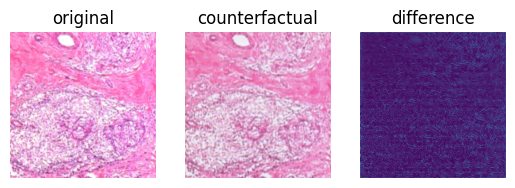

*** sample 27
[0.1028 0.1049 0.103  0.1057 0.1032 0.2748 0.1028 0.1028]
[0.2796 0.1029 0.1029 0.1029 0.1029 0.103  0.103  0.1029]


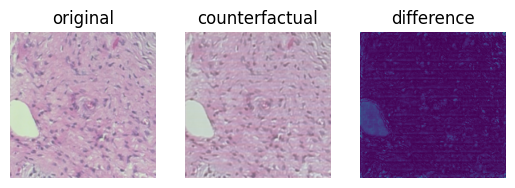

*** sample 28
[0.0875 0.2376 0.0874 0.2376 0.0874 0.0875 0.0874 0.0874]
[0.2517 0.0945 0.0931 0.1868 0.0931 0.0946 0.0931 0.0931]


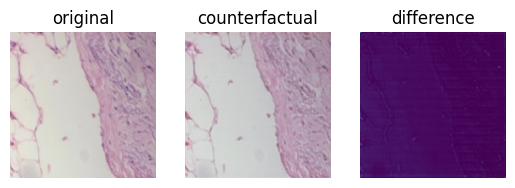

*** sample 29
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


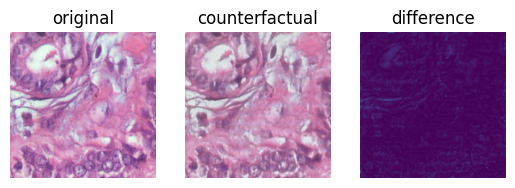

*** sample 30
[0.131  0.0997 0.1002 0.2704 0.0997 0.0997 0.0997 0.0997]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


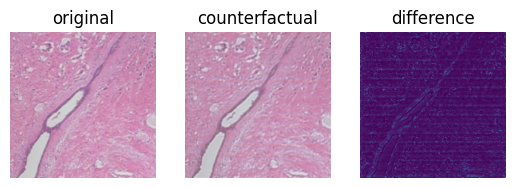

*** sample 31
[0.1029 0.1029 0.2794 0.1029 0.1031 0.1029 0.1029 0.103 ]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


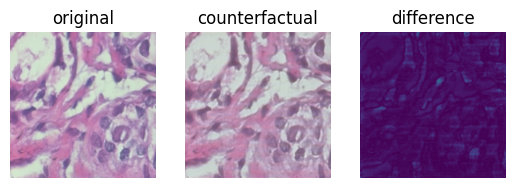

In [ ]:
plot_generated_images(train_datagen[0][0], model, classifier)

1/1 [==============================] - 0s 65ms/step
(32, 256, 256, 3) (32, 8)
*** sample 0
[0.1031 0.1028 0.1029 0.103  0.1029 0.1029 0.2795 0.1029]
[0.144  0.1143 0.1152 0.1569 0.1142 0.114  0.1267 0.1146]


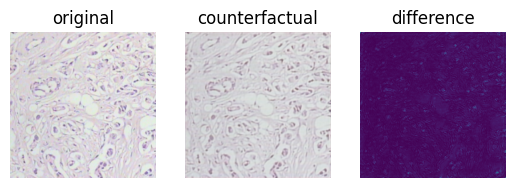

*** sample 1
[0.1026 0.2789 0.1026 0.1054 0.1026 0.1026 0.1026 0.1026]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


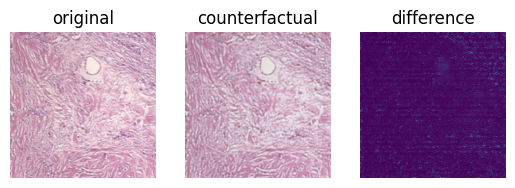

*** sample 2
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.103  0.1029]


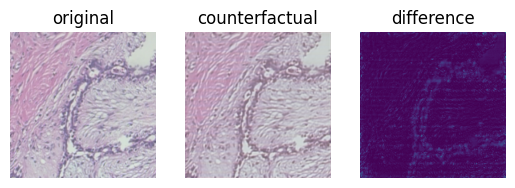

*** sample 3
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2792 0.1036 0.103  0.1031 0.1031 0.1027 0.1027 0.1027]


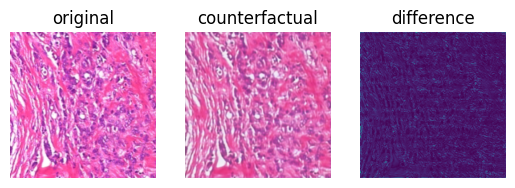

*** sample 4
[0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029 0.1029]
[0.2742 0.1016 0.1026 0.1119 0.1016 0.1017 0.1049 0.1014]


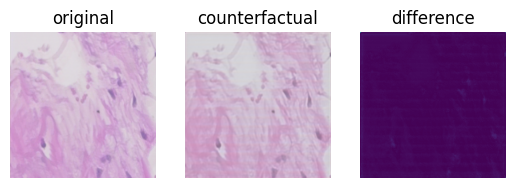

*** sample 5
[0.101  0.1011 0.2731 0.101  0.1209 0.101  0.101  0.101 ]
[0.2794 0.1028 0.1033 0.1028 0.1029 0.1028 0.1031 0.1028]


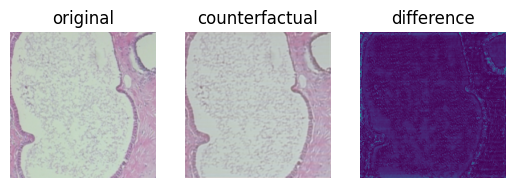

*** sample 6
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2735 0.1129 0.1022 0.1021 0.1031 0.1026 0.1018 0.1017]


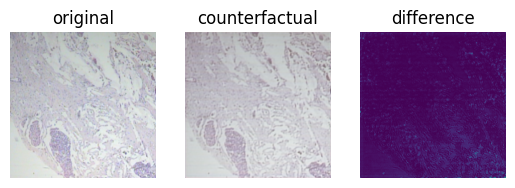

*** sample 7
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2779 0.1028 0.1031 0.1026 0.1034 0.1044 0.1033 0.1024]


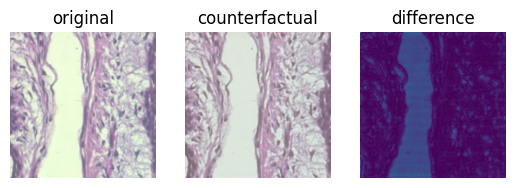

*** sample 8
[0.103  0.1029 0.1029 0.2796 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


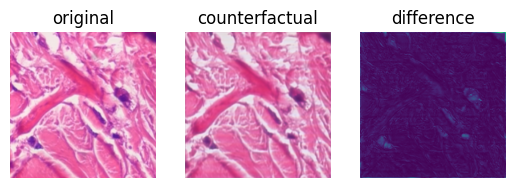

*** sample 9
[0.1035 0.1027 0.1028 0.1027 0.1036 0.1028 0.1027 0.2792]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


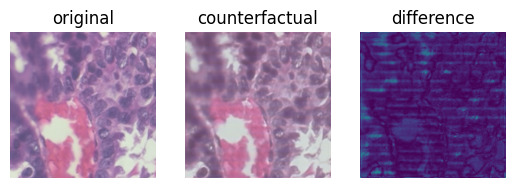

*** sample 10
[0.1044 0.1026 0.1026 0.1029 0.2778 0.1027 0.1044 0.1026]
[0.2794 0.1028 0.1031 0.1029 0.1032 0.1028 0.103  0.1028]


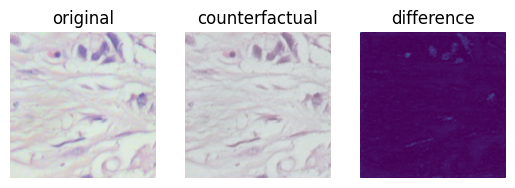

*** sample 11
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2787 0.1038 0.1028 0.1029 0.1031 0.103  0.1028 0.1028]


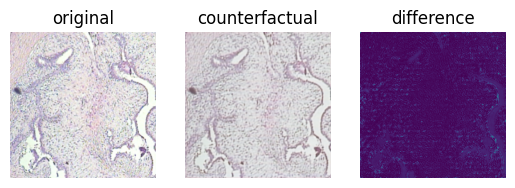

*** sample 12
[0.1029 0.103  0.1029 0.1029 0.1029 0.1029 0.2797 0.1029]
[0.2778 0.1022 0.1022 0.1022 0.1022 0.1022 0.1089 0.1022]


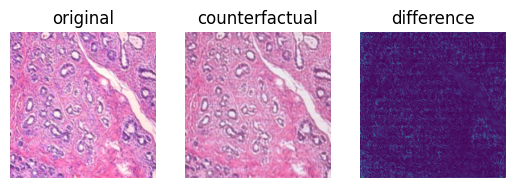

*** sample 13
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2794 0.1028 0.1028 0.1029 0.1028 0.1028 0.1028 0.1037]


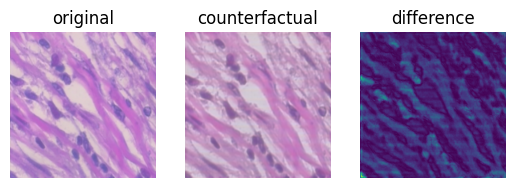

*** sample 14
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2795 0.103  0.1029 0.1029 0.103  0.103  0.103  0.1028]


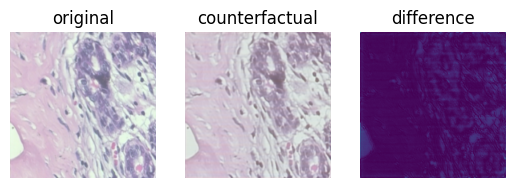

*** sample 15
[0.0876 0.2372 0.0874 0.2369 0.0881 0.0875 0.0878 0.0875]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


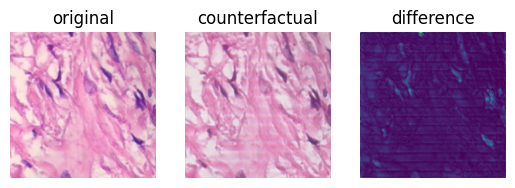

*** sample 16
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2795 0.1028 0.1028 0.1028 0.1028 0.1028 0.1034 0.1028]


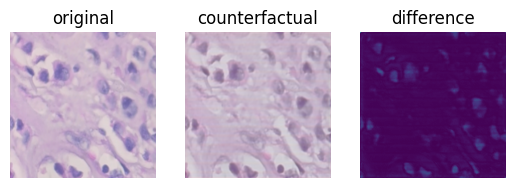

*** sample 17
[0.1023 0.1082 0.1023 0.278  0.1023 0.1023 0.1023 0.1023]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


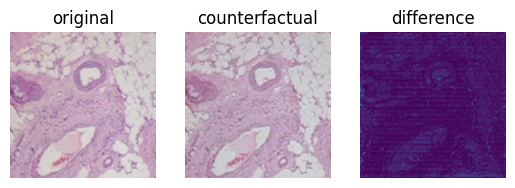

*** sample 18
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


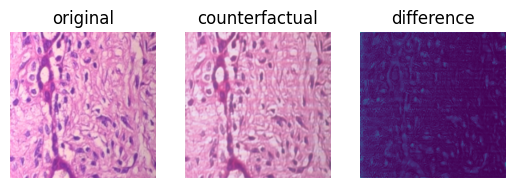

*** sample 19
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


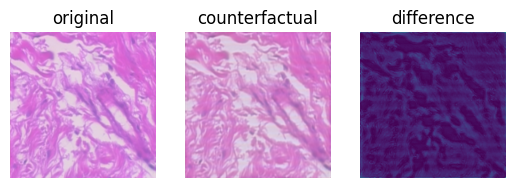

*** sample 20
[0.247  0.0918 0.0918 0.2021 0.0918 0.0918 0.0919 0.0918]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


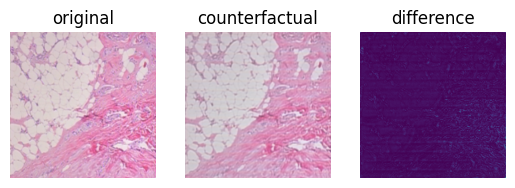

*** sample 21
[0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029 0.1029]
[0.2796 0.1029 0.1029 0.103  0.1029 0.103  0.1029 0.1029]


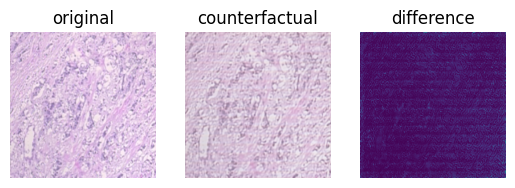

*** sample 22
[0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.2797]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


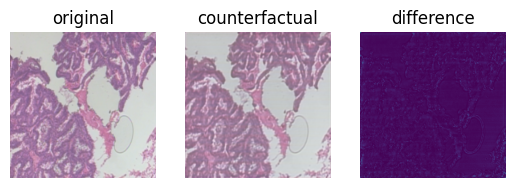

*** sample 23
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2719 0.1    0.1    0.1    0.1279 0.1    0.1    0.1   ]


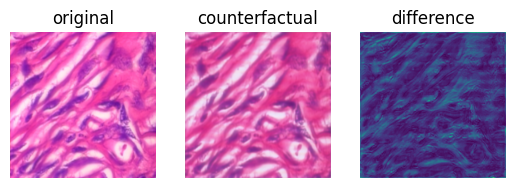

*** sample 24
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


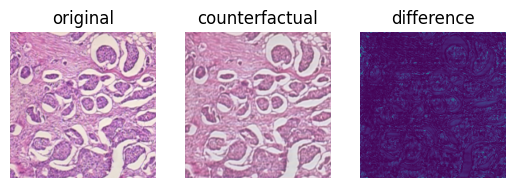

*** sample 25
[0.1024 0.2785 0.1024 0.1024 0.1069 0.1024 0.1024 0.1024]
[0.2796 0.1029 0.1029 0.1029 0.103  0.1029 0.103  0.1029]


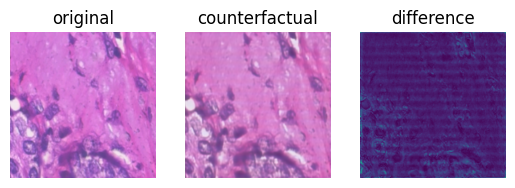

*** sample 26
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2796 0.1031 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


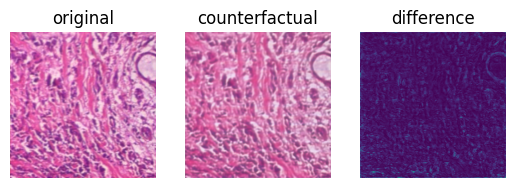

*** sample 27
[0.1028 0.1029 0.1028 0.1029 0.1033 0.1028 0.103  0.2795]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


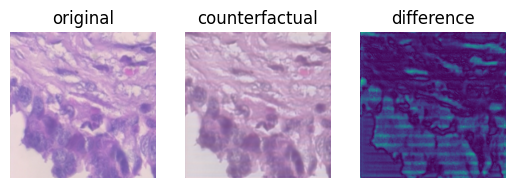

*** sample 28
[0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.2797]
[0.2795 0.1029 0.1029 0.1029 0.1029 0.103  0.103  0.103 ]


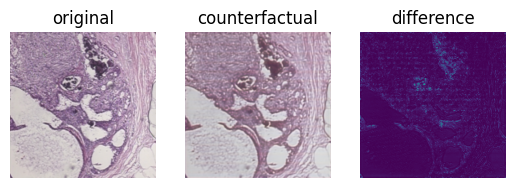

*** sample 29
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.103  0.1029]


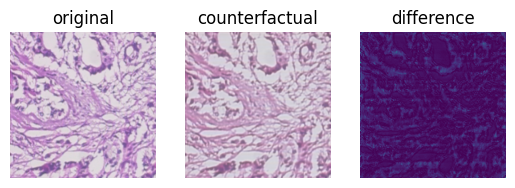

*** sample 30
[0.1026 0.1052 0.1026 0.2773 0.1036 0.1033 0.1027 0.1027]
[0.2415 0.0988 0.0987 0.165  0.0987 0.0999 0.0987 0.0987]


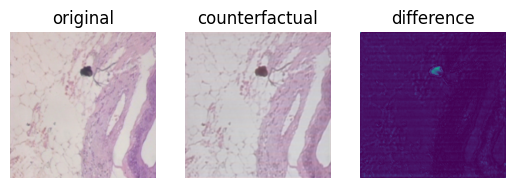

*** sample 31
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


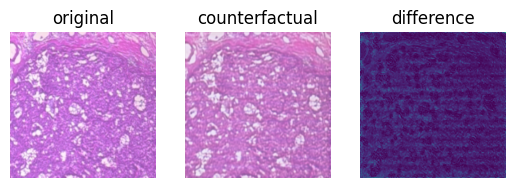

In [ ]:
plot_generated_images(train_datagen[32][0], model, classifier)

1/1 [==============================] - 0s 54ms/step
(32, 256, 256, 3) (32, 8)
*** sample 0
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


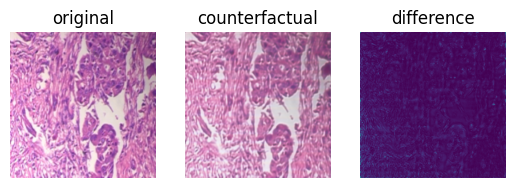

*** sample 1
[0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.2797]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


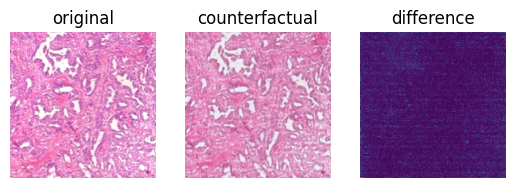

*** sample 2
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.278  0.1028 0.1028 0.1028 0.1029 0.1053 0.1027 0.1027]


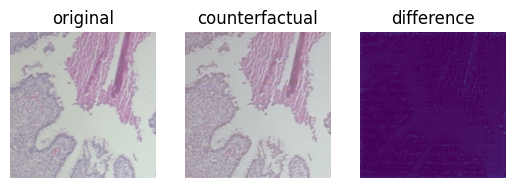

*** sample 3
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


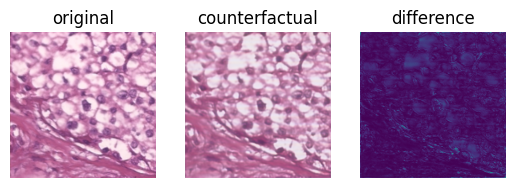

*** sample 4
[0.1027 0.1026 0.1026 0.1026 0.1058 0.1026 0.2787 0.1026]
[0.2699 0.0994 0.0996 0.0994 0.0994 0.0994 0.1334 0.0994]


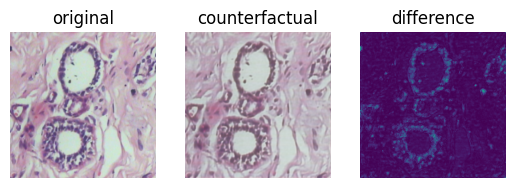

*** sample 5
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2795 0.1028 0.1028 0.1028 0.1035 0.1028 0.1028 0.1028]


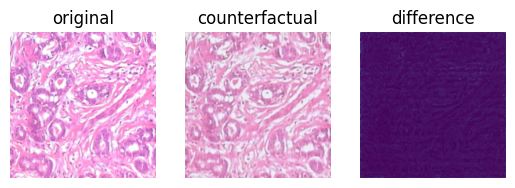

*** sample 6
[0.1029 0.2796 0.1029 0.1031 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


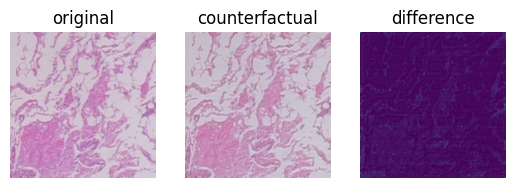

*** sample 7
[0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029 0.1029]
[0.2787 0.1025 0.1026 0.1058 0.1025 0.1028 0.1026 0.1025]


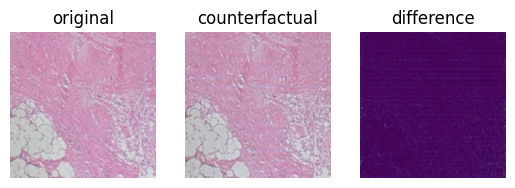

*** sample 8
[0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.2797 0.1029]
[0.2792 0.1027 0.1027 0.1027 0.1027 0.1027 0.1046 0.1027]


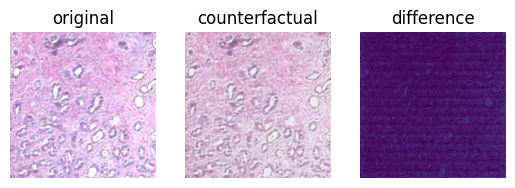

*** sample 9
[0.1028 0.2792 0.1028 0.103  0.1036 0.1028 0.1028 0.103 ]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


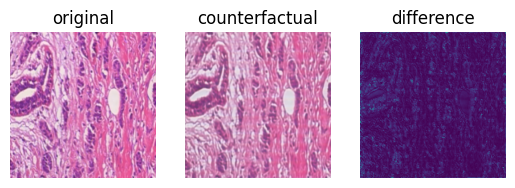

*** sample 10
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.103  0.1029]


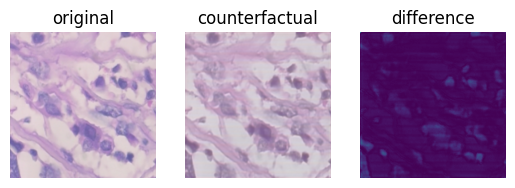

*** sample 11
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2779 0.1042 0.1027 0.1034 0.103  0.1038 0.1026 0.1024]


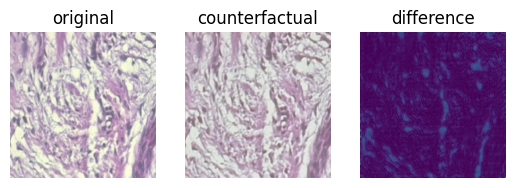

*** sample 12
[0.1086 0.2779 0.1023 0.1022 0.1023 0.1022 0.1022 0.1023]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


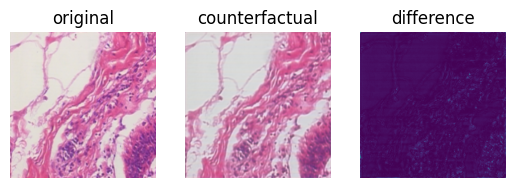

*** sample 13
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.277  0.1032 0.1023 0.1022 0.1073 0.1037 0.1022 0.1022]


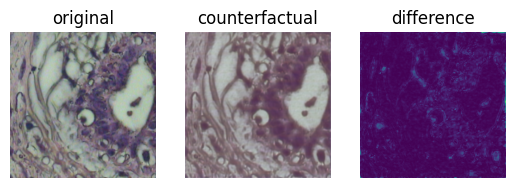

*** sample 14
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2792 0.1028 0.1028 0.1034 0.1027 0.1036 0.1028 0.1027]


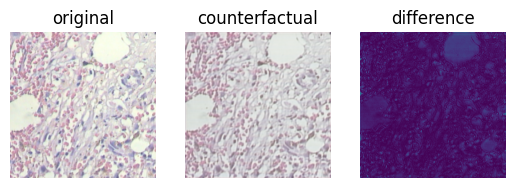

*** sample 15
[0.1033 0.1029 0.1029 0.1029 0.2796 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


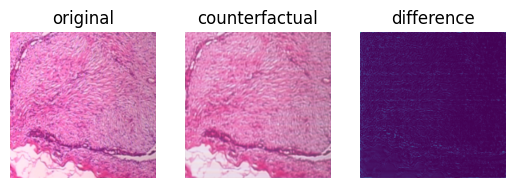

*** sample 16
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2794 0.1028 0.1028 0.1028 0.1028 0.1038 0.1028 0.1028]


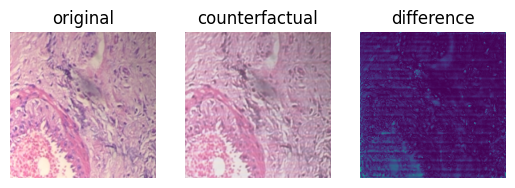

*** sample 17
[0.1033 0.2795 0.1028 0.1028 0.1028 0.1029 0.1028 0.1028]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


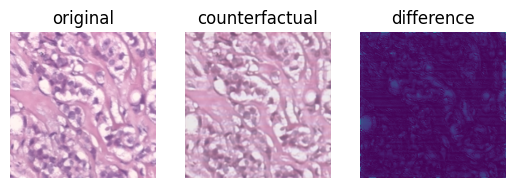

*** sample 18
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.1856 0.2438 0.0949 0.0966 0.0946 0.0949 0.095  0.0945]


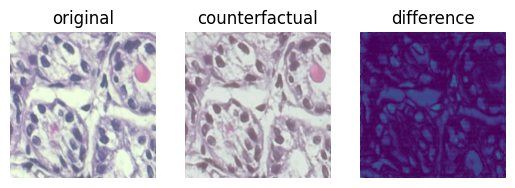

*** sample 19
[0.1057 0.1026 0.1026 0.2788 0.1026 0.1026 0.1027 0.1026]
[0.2797 0.1029 0.1029 0.103  0.1029 0.1029 0.1029 0.1029]


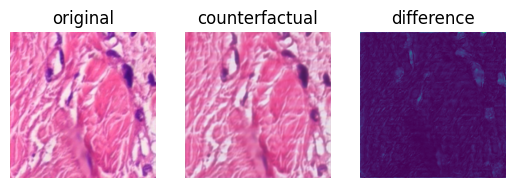

*** sample 20
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


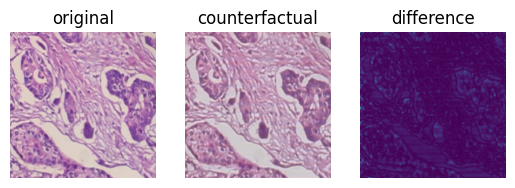

*** sample 21
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2787 0.1028 0.1029 0.1038 0.1031 0.1032 0.1029 0.1026]


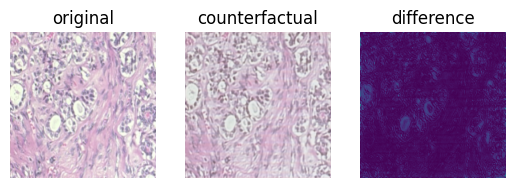

*** sample 22
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2747 0.1037 0.1031 0.1045 0.1032 0.1042 0.1035 0.1031]


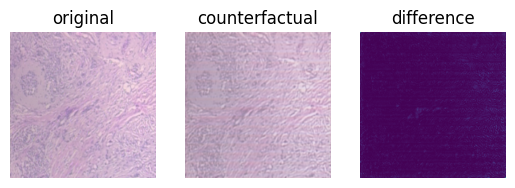

*** sample 23
[0.2797 0.1029 0.1029 0.1029 0.103  0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


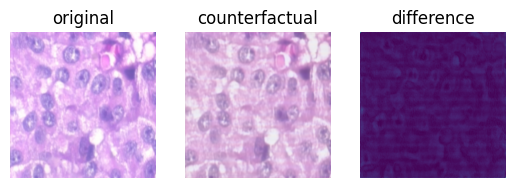

*** sample 24
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


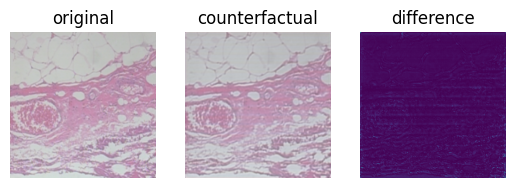

*** sample 25
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2226 0.1649 0.101  0.1019 0.1012 0.1064 0.101  0.101 ]


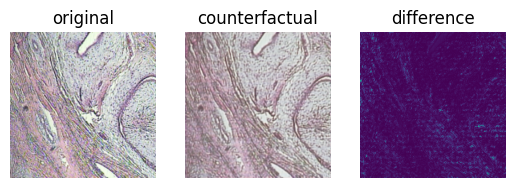

*** sample 26
[0.1093 0.2766 0.1018 0.105  0.1018 0.1018 0.1019 0.1018]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


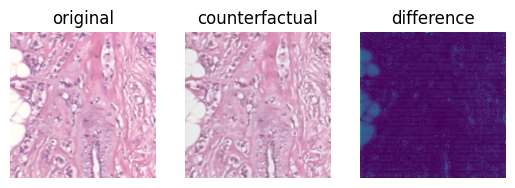

*** sample 27
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


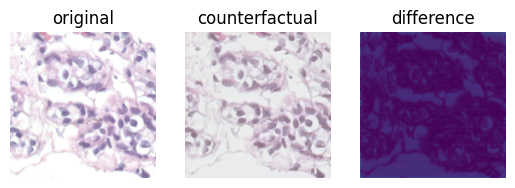

*** sample 28
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2795 0.1028 0.1029 0.1028 0.1028 0.1028 0.1035 0.1028]


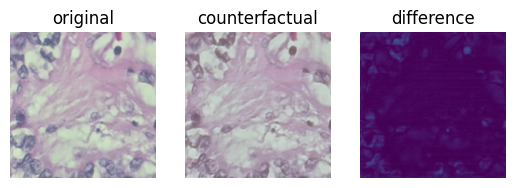

*** sample 29
[0.1014 0.101  0.1198 0.101  0.2738 0.101  0.101  0.101 ]
[0.2794 0.1028 0.1035 0.1029 0.1028 0.1028 0.1029 0.1028]


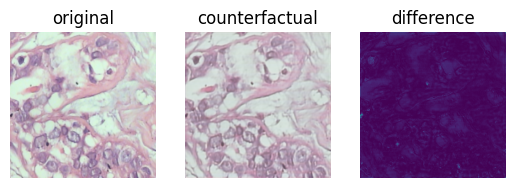

*** sample 30
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


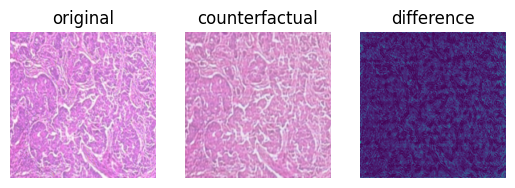

*** sample 31
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2786 0.1034 0.1027 0.1034 0.1033 0.1031 0.1027 0.1027]


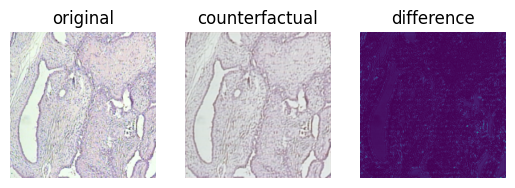

In [ ]:
plot_generated_images(train_datagen[64][0], model, classifier)

## validation

1/1 [==============================] - 0s 46ms/step
(32, 256, 256, 3) (32, 8)
*** sample 0
[0.1028 0.1038 0.1028 0.1031 0.2792 0.1028 0.1028 0.1027]
[0.2796 0.1029 0.1028 0.103  0.1031 0.1029 0.1029 0.1028]


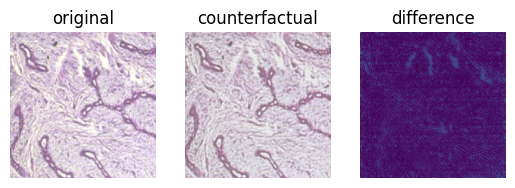

*** sample 1
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2796 0.103  0.1029 0.1029 0.1029 0.103  0.1029 0.1029]


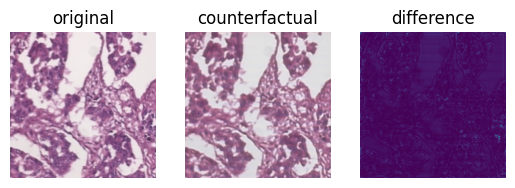

*** sample 2
[0.1025 0.1499 0.2511 0.099  0.1009 0.0988 0.0988 0.099 ]
[0.2511 0.0927 0.193  0.0927 0.0927 0.0926 0.0926 0.0927]


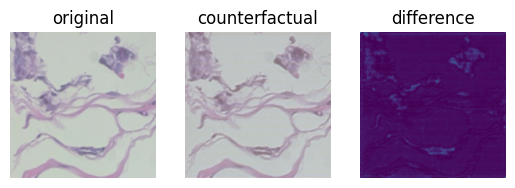

*** sample 3
[0.2793 0.103  0.103  0.103  0.103  0.103  0.103  0.103 ]
[0.2796 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


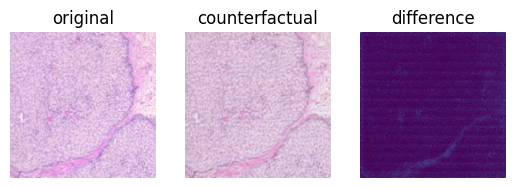

*** sample 4
[0.1028 0.2794 0.1028 0.1028 0.1039 0.1028 0.1028 0.1028]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


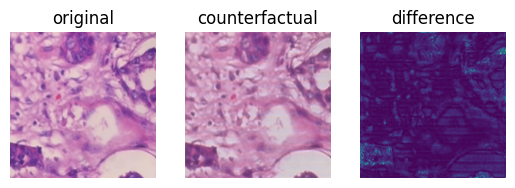

*** sample 5
[0.0996 0.1247 0.0996 0.0995 0.1073 0.0996 0.0995 0.2701]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


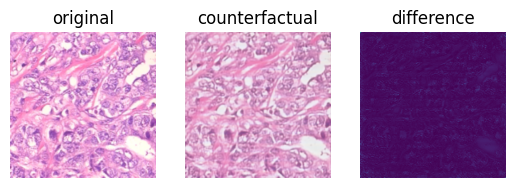

*** sample 6
[0.1159 0.2589 0.1011 0.1011 0.1194 0.1011 0.1011 0.1014]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


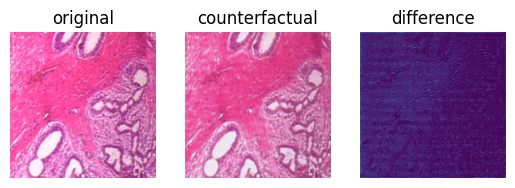

*** sample 7
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


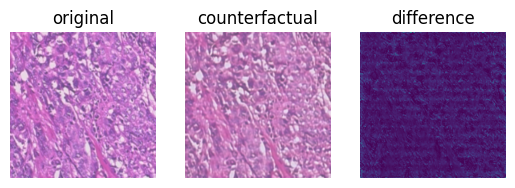

*** sample 8
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


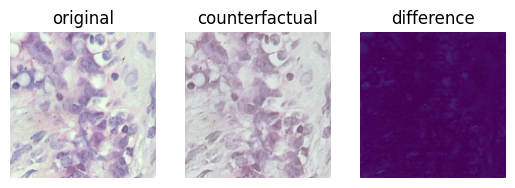

*** sample 9
[0.1025 0.1064 0.1025 0.1025 0.1025 0.1025 0.1025 0.2786]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


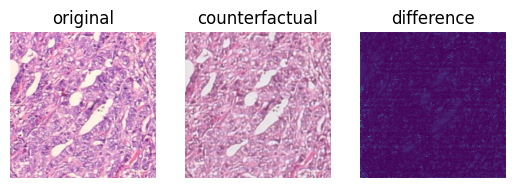

*** sample 10
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2774 0.1044 0.1026 0.1046 0.1027 0.1036 0.1024 0.1023]


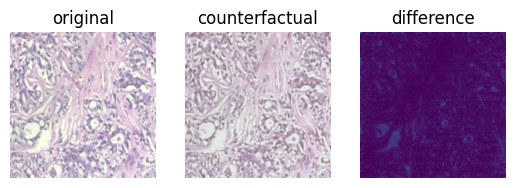

*** sample 11
[0.2796 0.103  0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


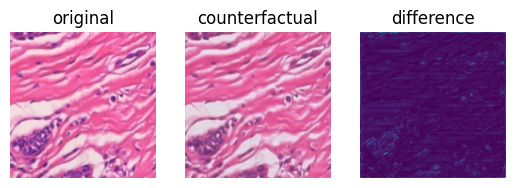

*** sample 12
[0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.2797 0.1029]
[0.2744 0.1069 0.102  0.102  0.1019 0.1085 0.1025 0.1019]


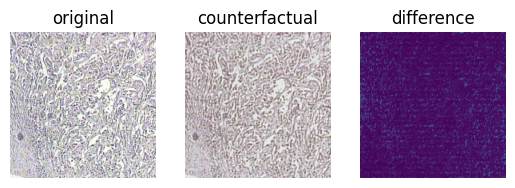

*** sample 13
[0.2232 0.0991 0.0993 0.0992 0.0991 0.0991 0.1818 0.0991]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


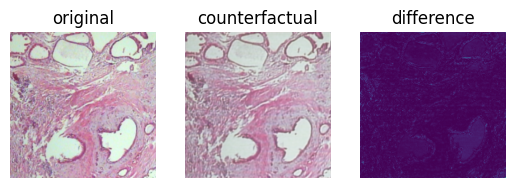

*** sample 14
[0.2643 0.0983 0.1452 0.1    0.0979 0.098  0.0981 0.0982]
[0.2796 0.1029 0.103  0.1029 0.1029 0.1029 0.1029 0.1029]


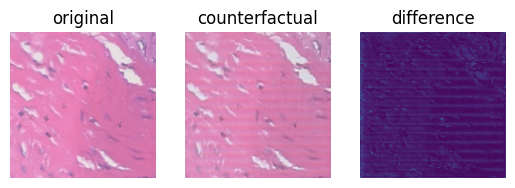

*** sample 15
[0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029 0.1029]
[0.2755 0.1017 0.1018 0.1138 0.1019 0.1018 0.1017 0.1017]


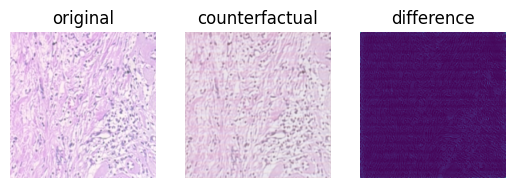

*** sample 16
[0.0883 0.2303 0.0883 0.0883 0.0883 0.0883 0.0883 0.24  ]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


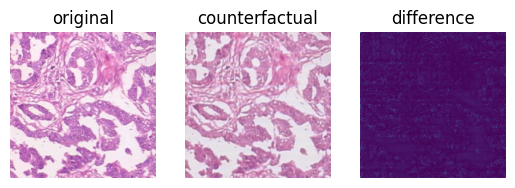

*** sample 17
[0.2343 0.0879 0.0879 0.0879 0.2379 0.0879 0.0882 0.0879]
[0.2794 0.1028 0.1028 0.1033 0.1028 0.1029 0.1031 0.1028]


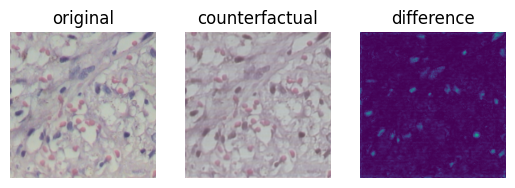

*** sample 18
[0.103  0.1029 0.1029 0.2795 0.1033 0.1029 0.1029 0.1029]
[0.278  0.1028 0.1027 0.1057 0.1027 0.1028 0.1027 0.1027]


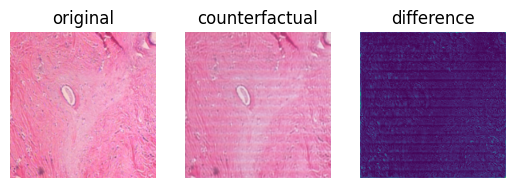

*** sample 19
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


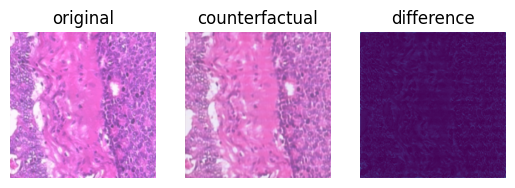

*** sample 20
[0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.2797 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.103  0.1029 0.1029]


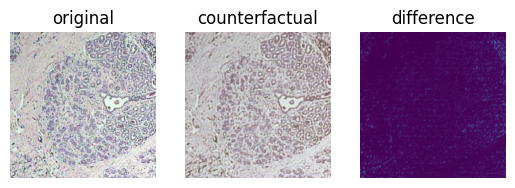

*** sample 21
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


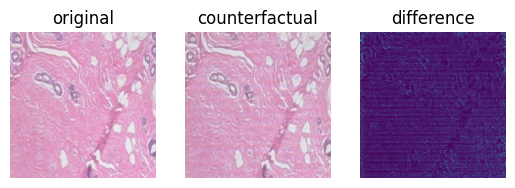

*** sample 22
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


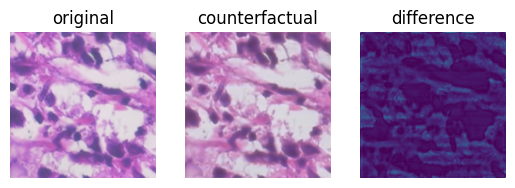

*** sample 23
[0.2784 0.1024 0.1032 0.1046 0.1041 0.1025 0.1024 0.1024]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


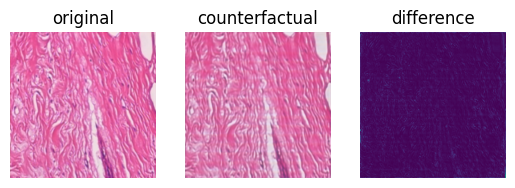

*** sample 24
[0.1022 0.2771 0.102  0.1023 0.11   0.102  0.1022 0.1022]
[0.2786 0.1026 0.1044 0.1027 0.1028 0.1026 0.1037 0.1025]


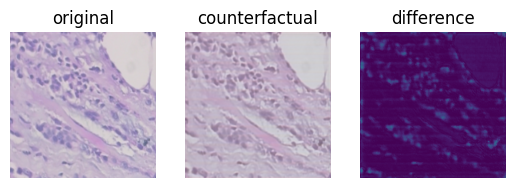

*** sample 25
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


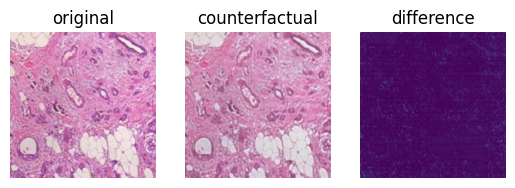

*** sample 26
[0.0987 0.0993 0.0987 0.0988 0.1655 0.0987 0.2416 0.0987]
[0.2796 0.1029 0.1029 0.1029 0.1029 0.1029 0.1031 0.1029]


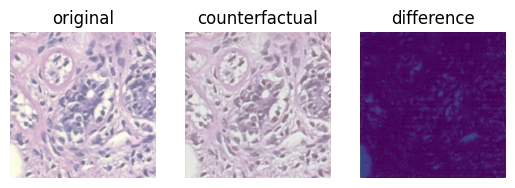

*** sample 27
[0.2791 0.1027 0.1027 0.1027 0.1036 0.1028 0.1028 0.1035]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


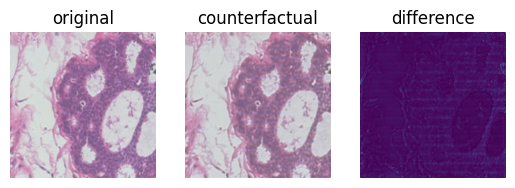

*** sample 28
[0.1029 0.2797 0.103  0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]


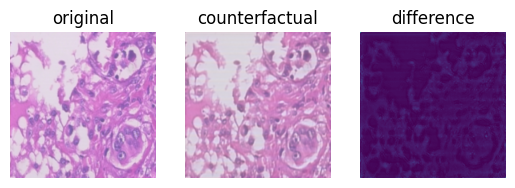

*** sample 29
[0.1029 0.1029 0.1029 0.1029 0.2797 0.1029 0.1029 0.1029]
[0.2795 0.1028 0.1028 0.1028 0.1035 0.1028 0.1029 0.1028]


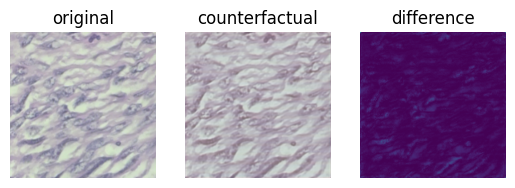

*** sample 30
[0.101  0.2734 0.1008 0.1183 0.1037 0.1009 0.1012 0.1008]
[0.2397 0.1054 0.1032 0.1282 0.1046 0.1035 0.1124 0.103 ]


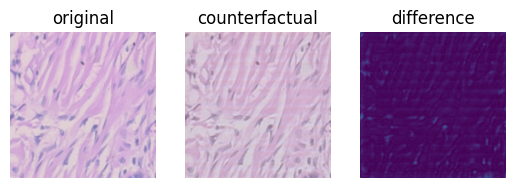

*** sample 31
[0.1029 0.2797 0.1029 0.1029 0.1029 0.1029 0.1029 0.1029]
[0.2796 0.1029 0.1029 0.1029 0.1031 0.1029 0.1029 0.103 ]


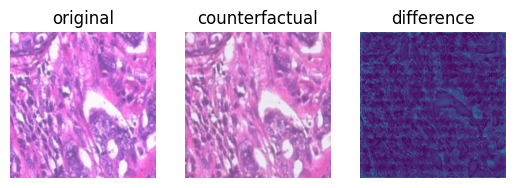

In [ ]:
plot_generated_images(val_datagen[0][0], model, classifier)

In [25]:
plot_generated_images(val_datagen[16][0], model, classifier)

Output hidden; open in https://colab.research.google.com to view.

In [28]:
plot_generated_images(val_datagen[30][0], model, classifier)

Output hidden; open in https://colab.research.google.com to view.

## test

In [22]:
plot_generated_images(test_datagen[0][0], model, classifier)

Output hidden; open in https://colab.research.google.com to view.

In [23]:
plot_generated_images(test_datagen[32][0], model, classifier)

Output hidden; open in https://colab.research.google.com to view.

In [24]:
plot_generated_images(test_datagen[-1][0], model, classifier)

Output hidden; open in https://colab.research.google.com to view.

# Evaluation - Confidence Diff

In [29]:
def compute_confidence_diff(datagen, tag_subset, generator, classifier):
    df = {'Y_cls_original':[],
          'Y_cls_counter':[]}
    for X, Ys in datagen:
        X_, _ = generator.predict(X, verbose=0)
        Y_cls_original = classifier.predict(X, verbose=0)
        Y_cls_counter = classifier.predict(X_, verbose=0)

        num = X.shape[0]
        Y_label = Ys['classifier256']
        class_ids = Y_label.argmax(axis=1)

        df['Y_cls_original'] += list(Y_cls_original[range(num), class_ids])
        df['Y_cls_counter'] += list(Y_cls_counter[range(num), class_ids])

        # print(class_ids)
        # print(Y_cls_original[range(num), class_ids])
        # print(Y_cls_counter[range(num), class_ids])

    df = pd.DataFrame(df)
    df.to_csv('eval_confidence_diff_%s.csv'%(tag_subset))

In [30]:
compute_confidence_diff(train_datagen, 'train', model, classifier)

In [31]:
compute_confidence_diff(val_datagen, 'val', model, classifier)

In [32]:
compute_confidence_diff(test_datagen, 'test', model, classifier)

In [33]:
import os

def compute_result(filename):
    print(os.path.basename(filename))
    df = pd.read_csv(filename, header='infer')
    df['count_decline'] = (df['Y_cls_original'] > df['Y_cls_counter']).astype(int)
    df['percentage_decline'] = (df['Y_cls_original'] - df['Y_cls_counter']) / df['Y_cls_original']

    count_decline = df['count_decline'].sum() / df['count_decline'].count()
    percentage_decline = df[df['count_decline'] == 1]['percentage_decline'].mean()
    print('count_decline =', count_decline)
    print('percentage_decline =', percentage_decline)
    return df

In [34]:
df = compute_result(
    'eval_confidence_diff_train.csv')
df = compute_result(
    'eval_confidence_diff_val.csv')
df = compute_result(
    'eval_confidence_diff_test.csv')

eval_confidence_diff_train.csv
count_decline = 0.99425
percentage_decline = 0.5488066598470647
eval_confidence_diff_val.csv
count_decline = 0.913
percentage_decline = 0.5195028366513617
eval_confidence_diff_test.csv
count_decline = 0.9013406668958405
percentage_decline = 0.52615904099288
